# World Water Toolbox - Step by step 

This is an example of the processing chain of using the World Water Toolbox on the openEO Platform. 
The approach integrates multi-temporal observations from Sentinel-1 and Sentinel-2 to map surface water at monthly/seasonal/annual intervals across the time-series.

- Import libraries

In [1]:

import openeo
from openeo.extra.spectral_indices.spectral_indices import append_index,append_indices
from openeo.processes import exp, array_element,log, count,normalized_difference, gte, eq, neq, sum
from openeo.processes import if_
from openeo.udf.debug import inspect
import numpy as np
import pathlib
from datetime import datetime
from dateutil.relativedelta import *
import xarray as xr
from eo_utils_ANSU import *

 - authenticate_oidc with the openeo backend 

In [16]:
connection = openeo.connect("openeo.vito.be").authenticate_oidc()  #openeo.cloud #openeo-dev.vito.be
# connection.describe_account()

Authenticated using refresh token.


# Input parameters


- Specify the Area of Interest

In [17]:
# Mexico Villa Victoria
center = [19.462,-99.95]
zoom   = 12.54
eoMap  = openMap(center,zoom)
eoMap.map

Map(center=[19.462, -99.95], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom…

* Specify temporal extent and bands:

In [39]:
# Mexico - Victoria lake
start_date           = '2021-05-01'
bbox                 = eoMap.getBbox()
spatial_extent       = {'west':bbox[0],'east':bbox[2],'south':bbox[1],'north':bbox[3],'crs':4326}

# spatial_extent= {'west': -100.1202964782715, 'east': -99.9038314819336, 'south': 19.429686571587766, 'north': 19.494427786331926, 'crs': 4326}

print('west',bbox[0],'\neast',bbox[2],'\nsouth',bbox[1],'\nnorth',bbox[3])
print(spatial_extent)

## Get the Sentinel-2 data for a 2 month window.
start_date_dt_object = datetime.strptime(start_date, '%Y-%m-%d')
end_date             = (start_date_dt_object + relativedelta(months = +1)).date() ## End date, 1 month later (1st Feb. 2021)
start_date_exclusion = (start_date_dt_object + relativedelta(months = -1)).date() ## exclusion date, to give a 1 month window.



west -100.10759353637695 
east -99.79242324829103 
south 19.429686571587766 
north 19.494427786331926
{'west': -100.10759353637695, 'east': -99.79242324829103, 'south': 19.429686571587766, 'north': 19.494427786331926, 'crs': 4326}


Check & download results: https://editor.openeo.org/

# 1 ) *Sentinel-2 ARD Pre-Processing*


* Specify collections :
  
  * **SENTINEL2_L1C** (EODC) - Missing Zenith Azimuth, support FORCE and Fmask

  * **SENTINEL2_L1C_SENTINELHUB** (TerraScope backend) - supports SMAC and iCor atmospheric correction

  * **boa_sentinel_2** (EODC) -  (ARD)  processed with FORCE. Missing Zenith and Azimuth information, cloud mask needs to be applied

  * **SENTINEL2_L2A_SENTINELHUB** (TerraScope backend) - Having Zenith and Azimuth information,  (ARD) processed with sen2cor, cloud mask needs to be applied

  Read more about ARD https://docs.openeo.cloud/usecases/ard/msi/#reference-implementations



-  Specify the region based on this webpage https://ecoregions.appspot.com/ 

In [41]:

LOOKUPTABLE = {
        
        "Deserts": {
            "S1": lambda vh, vv: 1 / (1 + exp(- (-7.03 + (-0.44 * vv)))),
            "S2": lambda ndvi, ndwi: 1 / (1 + exp(- (0.133 + (-5.92 * ndvi) + (14.82 * ndwi)))),
            "S1_S2": lambda vv, ndvi, ndwi: 1 / (1 + exp(- (-3.69 + (-0.25 * vv) + (0.47 * ndvi) + (15.3 * ndwi)))),
        },
        "Mountain": {
            "S1": lambda vh, vv: 1 / (1 + exp(- (-3.76 + (-0.262 * vv)))),
            "S2": lambda ndvi, ndwi: 1 / (1 + exp(- (0.262 + (0.75 * ndvi) + (12.65 * ndwi)))),
            "S1_S2": lambda vv, ndvi, ndwi: 1 / (1 + exp(- (-1.13 + (-0.11 * vv) + (3.03 * ndvi) + (13.21 * ndwi)))),
        },
        "Tropical forest":
            {
                "S1": lambda vh, vv: (1 / (1 + exp(- (-5.8 + (-0.415 * vv))))),
                "S2": lambda ndvi, ndwi: (1 / (1 + exp(- (0.344 + (2.886 * ndvi) + (11.91 * ndwi))))),
                "S1_S2": lambda vv, ndvi, ndwi: (1 / (1 + exp(- (-3.25 + (-0.23 * vv) + (4.17 * ndvi) + (9.5 * ndwi))))),
        },
         "Tropical savanna":
            {
                "S1": lambda vh, vv: (1 / (1 + exp(- (-7.0 + (-0.444 * vv))))),
                "S2": lambda ndvi, ndwi: (1 / (1 + exp(- (0.344 + (2.886 * ndvi) + (11.91 * ndwi))))),
                "S1_S2": lambda vv, ndvi, ndwi: (1 / (1 + exp(- (-1.06 + (-0.17 * vv) + (3.82* ndvi) + (14.4* ndwi))))),
        },
        "Subtropical dry":
            {
                "S1": lambda vh, vv: 1 / (1 + exp(- (-7.17 + (-0.48 * vv)))),
                "S2": lambda ndvi, ndwi: 1 / (1 + exp(- (0.845 + (2.14 * ndvi) + (13.5 * ndwi)))),
                "S1_S2": lambda vv, ndvi, ndwi: 1 / (1 + exp(- (-2.64 + (-0.23 * vv) + (8.6 * ndwi)))),
        },
        "Subtropical forest":
            {
                "S1": lambda vh, vv: 1 / (1 + exp(- (-6.67 + (-6.67* vv)))),
                "S2": lambda ndvi, ndwi: 1 / (1 + exp(- (0.712 + (-1.133 * ndvi) + (7.16 * ndwi)))),
                "S1_S2": lambda vv, ndvi, ndwi: 1 / (1 + exp(- (-2.72 + (-0.22 * vv) + (-0.49  * ndvi) + 4.55 * ndwi))),
        },
        "Temperate broadleaf":
            {
            "S1": lambda  vh, vv: 1 / (1 + exp(- (-8.82 + (-0.58 * vv)))),
            "S2": lambda ndvi, ndwi: 1 / (1 + exp(- (-0.013 + (5.38 * ndvi)) + (13.79 * ndwi))),
            "S1_S2": lambda vv, ndvi, ndwi: 1 / (1 + exp(- (-2.7 + (-0.2 * vv)) + (3.6 * ndvi)) + (9.73 * ndwi))
        },
        "Temperate grassland":
            {
            "S1": lambda  vh, vv: 1 / (1 + exp(- (-7.01 + (-0.426 * vv)))),
            "S2": lambda ndvi, ndwi: 1 / (1 + exp(- (1.286 + (8.74 * ndvi)) + (23.217 * ndwi))),
            "S1_S2": lambda vv, ndvi, ndwi: 1 / (1 + exp(- (-3.43 + (-0.25 * vv)) + (11.74 * ndvi)) + (22.035 * ndwi))
            }
        }

zone                 = "Tropical savanna"


*A)  Load S2 collection for a 2 month window*

In [42]:
s2_cube = connection.load_collection(
    'SENTINEL2_L2A_SENTINELHUB',
    spatial_extent=spatial_extent,
    temporal_extent=[start_date_exclusion, end_date],
    bands=['B02', 'B03', 'B04', 'B08', 'sunAzimuthAngles', 'sunZenithAngles'])

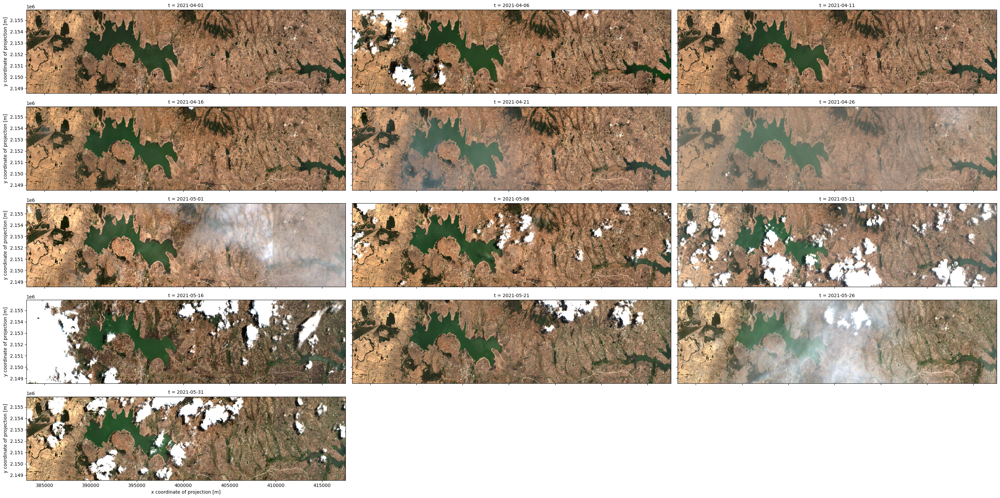

In [43]:
s2_cube = connection.load_collection(
    'SENTINEL2_L2A_SENTINELHUB',
    spatial_extent=spatial_extent,
    temporal_extent=[start_date_exclusion, end_date],
    bands=['B02', 'B03', 'B04', 'B08', 'sunAzimuthAngles', 'sunZenithAngles'])

# s2_cube_save = s2_cube.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_cube_save.send_job(title="S2L2A_cube")
# results = my_job.start_and_wait().get_results()
# results.download_files("S2L2A_cube")

ds_s2_cube = xr.open_dataset("S2L2A_cube/openEO.nc").load()
ds_s2_cube[['B04', 'B03', 'B02']].to_array().plot.imshow(x="x", robust=True, col ="t", col_wrap=3,vmin=0, vmax=3000,figsize=(30, 15))


*B) Mask Clouds, Shadows and Snow*


In [44]:

s2_cube_masking = connection.load_collection(
    'SENTINEL2_L2A_SENTINELHUB',
    spatial_extent=spatial_extent,
    temporal_extent=[start_date_exclusion, end_date],
    bands=['CLP', 'SCL'])

# SCL- Scene classification layer based on Sen2Cor:  scl == 3,8,9,10,11 (Cloud Shadows, Clouds medium probability, Clouds high probability, Cirrus, Snow / Ice)
scl = s2_cube_masking.band("SCL")
mask_scl = (scl == 3) | (scl == 8) | (scl == 9) | (scl == 10) | (scl == 11)

# CLP (cloud probability layer) based on S2cloudless (160 blocks and 10m resolution)
clp = s2_cube_masking.band("CLP")
mask_clp = mask_scl | (clp / 255) > 0.3
s2_cube = s2_cube.mask(mask_clp.resample_cube_spatial(s2_cube))

In [ ]:

s2_cube_masking = connection.load_collection(
    'SENTINEL2_L2A_SENTINELHUB',
    spatial_extent=spatial_extent,
    temporal_extent=[start_date_exclusion, end_date],
    bands=['CLP', 'SCL'])

# SCL- Scene classification layer based on Sen2Cor:  scl == 3,8,9,10,11 (Cloud Shadows, Clouds medium probability, Clouds high probability, Cirrus, Snow / Ice)
scl = s2_cube_masking.band("SCL")
mask_scl = (scl == 3) | (scl == 8) | (scl == 9) | (scl == 10) | (scl == 11)

# CLP (cloud probability layer) based on S2cloudless (160 blocks and 10m resolution)
clp = s2_cube_masking.band("CLP")
mask_clp = mask_scl | (clp / 255) > 0.3
s2_cube = s2_cube.mask(mask_clp.resample_cube_spatial(s2_cube))

# s2_cube_save = s2_cube.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_cube_save.send_job(title="s2_cube_cloudfree")
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_cube_cloudfree") 
 
ds_s2_cube_masked = xr.open_dataset("s2_cube_cloudfree/openEO.nc")
ds_s2_cube_masked[['B04', 'B03', 'B02']].to_array().plot.imshow(x="x", robust=True, col ="t", col_wrap=3,vmin=0, vmax=3000, figsize=(30, 15))


*C) Mask Terrain Shadow* In Progress 
- hillshade package opensource package maintained by DHI was installed on the platform

In [ ]:

dem_cube = connection.load_collection(
    "COPERNICUS_30",
    spatial_extent = spatial_extent,
    temporal_extent=["2010-01-01", "2030-12-31"],)

dem_cube = dem_cube.max_time()
dem_cube = dem_cube.resample_cube_spatial(s2_cube)
merged_cube = s2_cube.merge_cubes(dem_cube)


# Udf function importing hillshade packages 
udf_code = """

from openeo.udf import XarrayDataCube
from openeo.udf.debug import inspect
import numpy as np
from hillshade.hillshade import hillshade


def rasterize(azimuth, resolution=None):
    azimuth = np.deg2rad(azimuth)
    xdir, ydir = np.sin(azimuth), np.cos(azimuth)

    if resolution is not None:
        xdir = xdir * resolution[0]
        ydir = ydir * resolution[1]

    slope = ydir / xdir
    if slope < 1. and slope > -1.:
        xdir = 1.
        ydir = slope
    else:
        xdir = 1. / slope
        ydir = 1.
    return xdir, ydir

def _run_shader(sun_zenith, sun_azimuth, elevation_model, resolution_x, resolution_y):

    azimuth = np.nanmean(sun_azimuth.astype(np.float32))
    zenith = np.nanmean(sun_zenith.astype(np.float32))
    resolution = (float(resolution_x), float(resolution_y))
    ray_xdir, ray_ydir = rasterize(azimuth, resolution)

    # Assume chunking is already done by Dask
    ystart = 0
    yend = elevation_model.shape[0]

    # Make sure inputs have the right data type
    zenith = float(zenith)
    ray = (float(ray_xdir), float(ray_ydir))
    shadow = hillshade(elevation_model.astype(np.float32),
                       resolution,
                       zenith,
                       ray,
                       ystart,
                       yend)
    shadow = shadow.reshape(elevation_model.shape)
    shadow[np.isnan(sun_azimuth)] = 255
    return shadow


def apply_datacube(cube: XarrayDataCube, context: dict) -> XarrayDataCube:
    in_xarray = cube.get_array()
    sun_zenith = in_xarray.sel({"bands": "sunZenithAngles"}).values.astype(np.float32)
    sun_azimuth = in_xarray.sel({"bands": "sunAzimuthAngles"}).values.astype(np.float32)
    elevation_model = in_xarray.sel({"bands": "DEM"}).values.astype(np.float32)
    res_y = in_xarray.coords["y"][int(len(in_xarray.coords["y"])/2)+1] - in_xarray.coords["y"][int(len(in_xarray.coords["y"])/2)]
    res_x = in_xarray.coords["x"][int(len(in_xarray.coords["x"])/2)+1] - in_xarray.coords["x"][int(len(in_xarray.coords["x"])/2)]

    shadow = _run_shader(sun_zenith, sun_azimuth, elevation_model, res_x, res_y)
    cube.get_array().values[0] = shadow
    return cube

"""
process = openeo.UDF(code=udf_code, runtime="Python", data={"from_parameter": "x"})

# Shadow mask replaces the first band (B03) in the merged cube
hillshaded = merged_cube.apply(process=process)

# my_job  = hillshaded.send_job(title="hillshaded")
# results = my_job.start_and_wait().get_results()
# hillshaded = results.rename_labels("bands", ["hillshade_mask", "sunAzimuthAngles", "sunZenithAngles", "DEM"])
# hillshaded_mask = hillshaded.filter_bands(bands=['hillshade'])

# hillshaded_save = hillshaded.save_result(format='netCDF')
# my_job  = hillshaded_save.send_job(title="hillshaded")
# results = my_job.start_and_wait().get_results()
# results.download_files("hillshaded")

ds_hillshaded = xr.load_dataset("hillshaded/openEO.nc")
ds_hillshaded['B02'].plot.imshow(x="x", robust=True, col ="t", col_wrap=3, vmin=0, vmax=1, cmap = 'BrBG',   figsize=(30, 15))


- (Optional) Download and Visualize: 
1) DEM
2) Terrain Shadow mask - in progress using UDF 


In [ ]:
dem_save = dem_cube.save_result(format='netCDF') #GTiff #netCDF
my_job  = dem_save.send_job(title="dem")
results = my_job.start_and_wait().get_results()
results.download_files("dem") 

ds_dem = xr.load_dataset("dem/openEO.nc")
ds_dem["DEM"].plot(vmin=2500, vmax=3090, cmap='terrain', figsize=(20, 5))

D) NDVI and NDWI Calculation:
-   NDVI (Sentinel 2) = (B8 – B4) / (B8 + B4)
-   NDWI (Sentinel 2) = (B3 – B8) / (B3 + B8)

In [ ]:
s2_cube = append_indices(s2_cube, ["NDWI","NDVI"]) 

# s2_cube_save = s2_cube.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_cube_save.send_job(title="s2_cube_NDVI_NDWI")#
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_cube_NDVI_NDWI") 

ds_s2_cube_ndvi_ndwi = xr.open_dataset("s2_cube_NDVI_NDWI/openEO.nc").load()
ds_s2_cube_ndvi_ndwi['NDWI'].plot.imshow(x="x", col = "t", robust=True, col_wrap=3, vmin=-1, vmax=1, cmap = 'GnBu', figsize=(30, 15)); 
ds_s2_cube_ndvi_ndwi['NDVI'].plot.imshow(x="x", col = "t", robust=True, col_wrap=3, vmin=-1, vmax=1, cmap = 'viridis', figsize=(30, 15)); 

- E) Water probability for each image

In [ ]:
def water_function(data):
    return LOOKUPTABLE[zone]["S2"](ndwi=data[6], ndvi=data[7])

s2_cube_water = s2_cube.reduce_dimension(reducer=water_function, dimension="bands")
s2_cube_water = s2_cube_water.add_dimension("bands", "water_prob", type="bands")

# s2_cube_water_save = s2_cube_water.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_cube_water_save.send_job(title="s2_cube_water")
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_cube_water") 

ds_s2_cube_water = xr.open_dataset("s2_cube_water/openEO.nc").load()
ds_s2_cube_water['water_prob'].plot.imshow(x="x", col = "t",  robust=True, col_wrap=3, vmin=0, vmax=1, cmap = 'GnBu', figsize=(30, 15)) 

F) Calculate the median s2 water probability for 1-month.

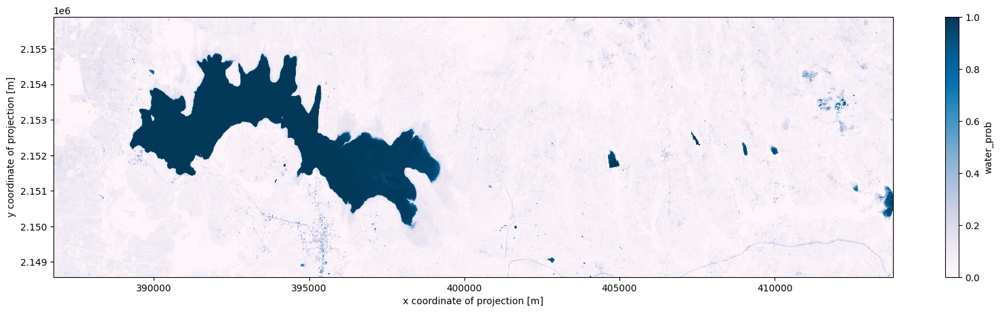

In [109]:

s2_median_water = s2_cube_water.filter_temporal([start_date, end_date]).median_time()

# s2_median_water = s2_median_water.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_median_water.send_job(title="s2_median_water")
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_median_water")

ds_s2_median_water = xr.open_dataset("s2_median_water/openEO.nc").load()
ds_s2_median_water['water_prob'].plot.imshow(x="x",robust=True, cmap = 'PuBu', vmin=0, vmax=1, figsize=(20, 5)); 

* G) Calculate the surface water frequency for 

*G.1) treshold of 75 on calculate water probability for each image*

*G.2) sum the number of Sentinel-2 Water observations above 0.75 threshold*

*G.3) count pixels (using B8) for all the non-masked areas and calculate the surface water frequencys: 2_cube_water_sum / s2_count*


*G.1) treshold of 75 on calculate water probability for each image*

In [ ]:

s2_cube_water_threshold = s2_cube_water.apply_dimension(dimension="bands", process=lambda x: if_(x > 0.75, x, 0))
s2_cube_water_threshold = s2_cube_water_threshold.rename_labels("bands", ["w_T75"])

# s2_cube_water_threshold_save = s2_cube_water_threshold.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_cube_water_threshold_save.send_job(title="s2_cube_water_threshold")
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_cube_water_threshold")

ds_s2_cube_water_threshold = xr.open_dataset("s2_cube_water_threshold/openEO (3).nc").load()
ds_s2_cube_water_threshold['w_T75'].plot.imshow(x="x", col = "t",  robust=True, col_wrap=3, vmin=0, vmax=1, cmap = 'GnBu', figsize=(30, 15)); 


*G.2) Sum the number of Sentinel-2 Water observations above 0.75 threshold*

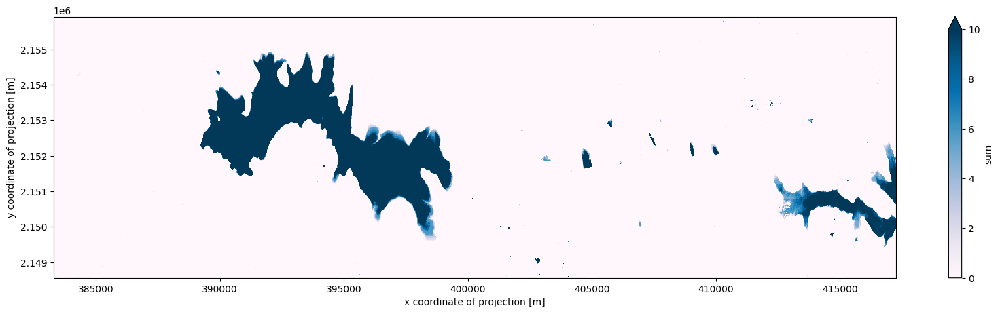

In [126]:
s2_cube_water_sum = s2_cube_water_threshold.reduce_dimension(reducer="sum", dimension="t")
s2_cube_water_sum = s2_cube_water_sum.rename_labels("bands", ["sum"])

# s2_cube_water_sum_save = s2_cube_water_sum.save_result(format='netCDF') 
# my_job  = s2_cube_water_sum_save.send_job(title="s2_cube_water_sum")
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_cube_water_sum") 

ds_s2_cube_water_sum = xr.open_dataset("s2_cube_water_sum/openEO.nc").load()
ds_s2_cube_water_sum['sum'].plot.imshow(x="x", robust=True,  cmap='PuBu', vmin=0, vmax=10, figsize=(20, 5));

*G.3) count pixels (using B8) for all the non-masked areas and calculate the surface water frequencys: 2_cube_water_sum / s2_count*

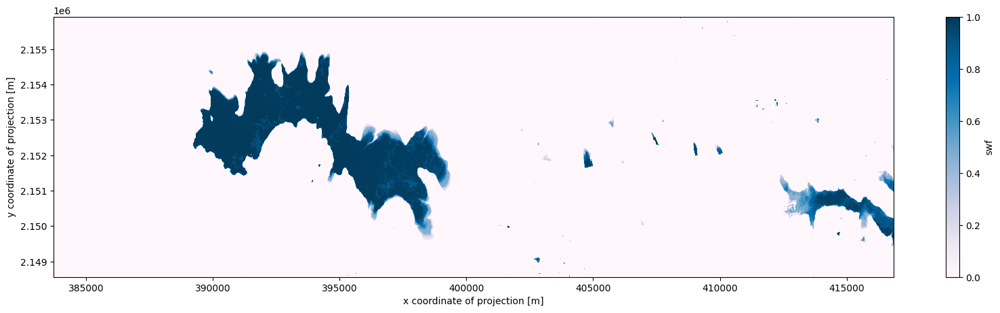

In [57]:

s2_count = s2_cube.filter_bands(bands=["B08"])
s2_count = s2_count.reduce_dimension(reducer=lambda data: data.count(), dimension="t")
s2_count = s2_count.rename_labels("bands", ["count"])

s2_cube_swf = s2_cube_water_sum.resample_cube_spatial(s2_count) / s2_count
s2_cube_swf = s2_cube_swf.rename_labels("bands", ["swf"])

# s2_cube_swf_save = s2_cube_swf.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_cube_swf_save.send_job(title="s2_cube_swf")
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_cube_swf") 

ds_s2_cube_swf = xr.open_dataset("s2_cube_swf/openEO (2).nc").load()
ds_s2_cube_swf['swf'].plot.imshow(x="x",robust=True, cmap='PuBu', vmin=0, vmax=1, figsize=(20, 5)); 


H) Calculate the median s2 RGB for 1-month.

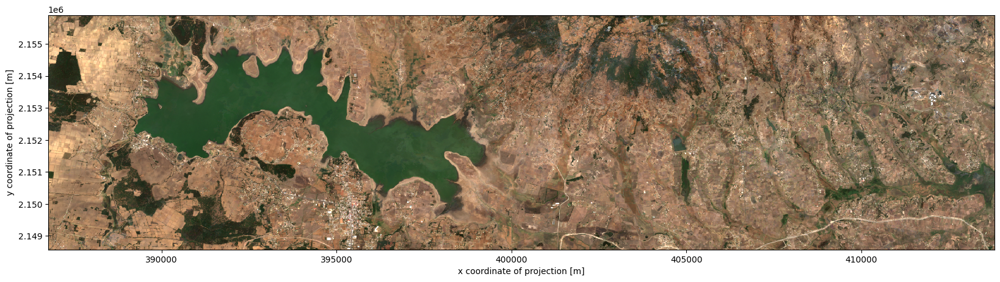

In [59]:
s2_cube_median = s2_cube.filter_temporal([start_date, end_date]).median_time()

# s2_cube_median_save = s2_cube_median.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s2_cube_median_save.send_job(title="s2_cube_median")
# results = my_job.start_and_wait().get_results()
# results.download_files("s2_cube_median")

ds_s2_median_water = xr.open_dataset("s2_cube_median/openEO.nc").load()
ds_s2_median_water[['B04', 'B03', 'B02']].to_array().plot.imshow(x="x", robust=True, vmin=0, vmax=3000, figsize=(20, 5));

# 2) *Sentinel-1 ARD Pre-Processing*

In [60]:

## Get Sentinel-1 data for a 1 month window and convert to ARD data.
s1_cube = connection.load_collection(
    'SENTINEL1_GRD',
    spatial_extent=spatial_extent,
    temporal_extent=[start_date, end_date],
    bands=['VH', 'VV'],
    properties={"polarization": lambda p: p == "DV"})
     

A) *Terrain correction using COPERNICUS_30*



In [61]:

s1_cube = s1_cube.sar_backscatter(coefficient="gamma0-terrain", mask=True, elevation_model="COPERNICUS_30")


B) *Mask Radar Shadow and calculation of median composite* 

In [ ]:
s1_cube = s1_cube.rename_labels("bands", ["VH", "VV", "mask", "incidence_angle"])
s1_cube_mask = s1_cube.band("mask")
s1_mask_RS = (s1_cube_mask == 2)
s1_cube = s1_cube.mask(s1_mask_RS)

# The final terrain-corrected values are converted to decibels via log scaling and calculation of median composite
def log_(x):
    return 10 * log(x, 10)

s1_median = s1_cube.median_time().apply(log_)

# s1_cube_save = s1_median.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s1_cube_save.create_job(title="s1_median")
# results = my_job.start_and_wait().get_results()
# results.download_files('s1_median')

ds_s1_median = xr.open_dataset("s1_median/openeo.nc").load()
ds_s1_median['VV'].plot.imshow(col_wrap=1, cmap= 'gray', figsize=(10, 5)) 
ds_s1_median['VH'].plot.imshow(col_wrap=1, cmap= 'gray', figsize=(10, 5)) 

C) *Calculate water probability for the S1 composite*
- We can see speckle noise or interference effect 

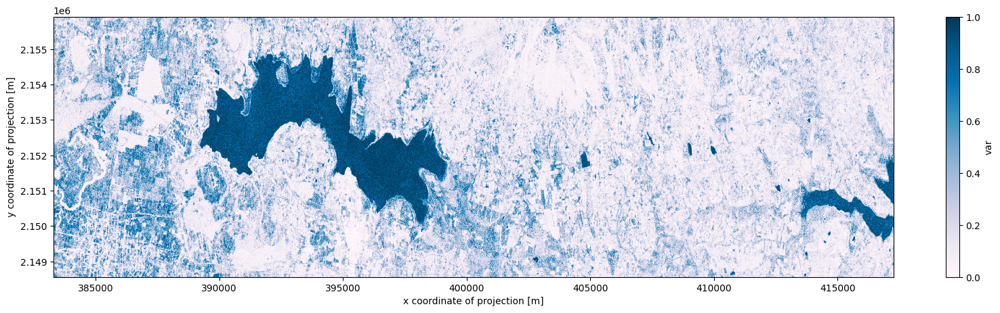

In [81]:
def s1_water_function(data):
    return LOOKUPTABLE[zone]["S1"](vh=data[0], vv=data[1])

s1_median_water = s1_median.reduce_dimension(reducer=s1_water_function, dimension="bands")

# s1_cube_save = s1_median_water.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s1_cube_save.create_job(title="s1_median_water")
# results = my_job.start_and_wait().get_results()
# results.download_files('s1_median_water')

ds_s1_median_water = xr.open_dataset("s1_median_water/openeo.nc").load()
ds_s1_median_water
ds_s1_median_water['var'].plot.imshow(x="x", robust=True, cmap = 'PuBu', vmin=0, vmax=1, figsize=(20, 5)); 


*D) Create an exclusion mask (using S2 2 months swf) for masking the SAR water extent in order to reduced ability of our algorithm to detect short-lived floods in their entirety*

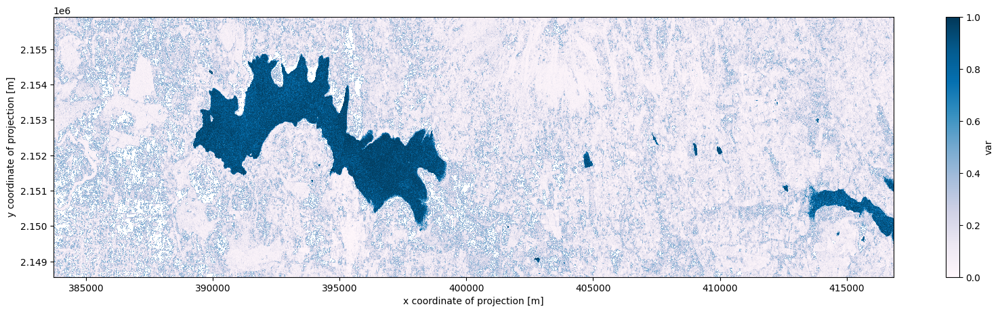

In [85]:

exclusion_mask = (s1_median_water.resample_cube_spatial(s2_cube_swf) > 0.5) & (s2_cube_swf < 0.33)
s1_median_water_mask = s1_median_water.mask(exclusion_mask.resample_cube_spatial(s1_median_water))

# s1_median_water_mask_save = s1_median_water_mask.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s1_median_water_mask_save.send_job(title="s1_median_water_mask")
# results = my_job.start_and_wait().get_results()
# results.download_files('s1_median_water_mask')

ds_s1_median_water_mask = xr.open_dataset("s1_median_water_mask/openEO.nc").load()
ds_s1_median_water_mask['var'].plot.imshow(x="x", robust=True, cmap = 'PuBu', vmin=0, vmax=1, figsize=(20, 5)) 


# 3) Fussion S1 and S2 for generating water probability using logistic expressions

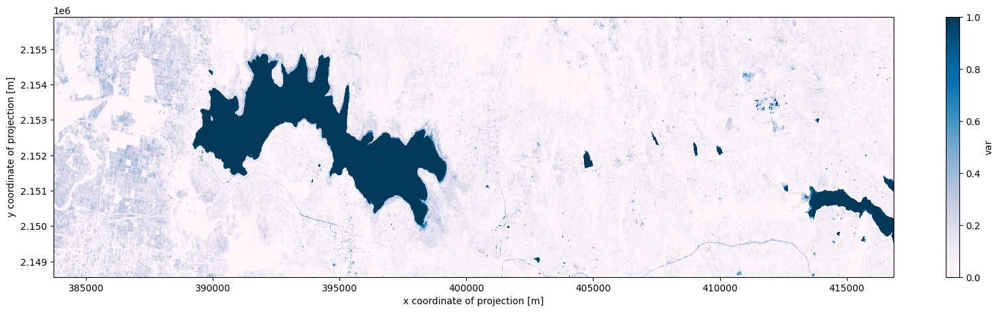

In [87]:
def s1_s2_water_function(data):
        return LOOKUPTABLE[zone]["S1_S2"](vv=data[0], ndvi=data[1], ndwi=data[2])

s1_s2_cube = s1_median.filter_bands(['VV']).resample_cube_spatial(s2_cube_median).merge_cubes(s2_cube_median.filter_bands(['NDVI','NDWI'])) 
s1_s2_water = s1_s2_cube.reduce_dimension(reducer=s1_s2_water_function, dimension="bands").add_dimension("bands", "var", type="bands")
s1_s2_water = s1_s2_water.rename_labels("bands", ["water_prob"])

# s1_s2_water_save = s1_s2_water.save_result(format='netCDF') #GTiff #netCDF
# my_job  = s1_s2_water_save.send_job(title="s1_s2_water")
# results = my_job.start_and_wait().get_results()
# results.download_files('s1_s2_water')

ds_s1_s2_water_save = xr.open_dataset("s1_s2_water/openEO.nc").load()
ds_s1_s2_water_save['var'].plot.imshow(x="x", robust=True,  cmap = 'PuBu', vmin=0, vmax=1, figsize=(20, 5)); 
                      

# 3) Surface Water

- A) Merge s1_water_prob cube, s2_water_prob cube and s1_s2_water prob cube using "sum" 

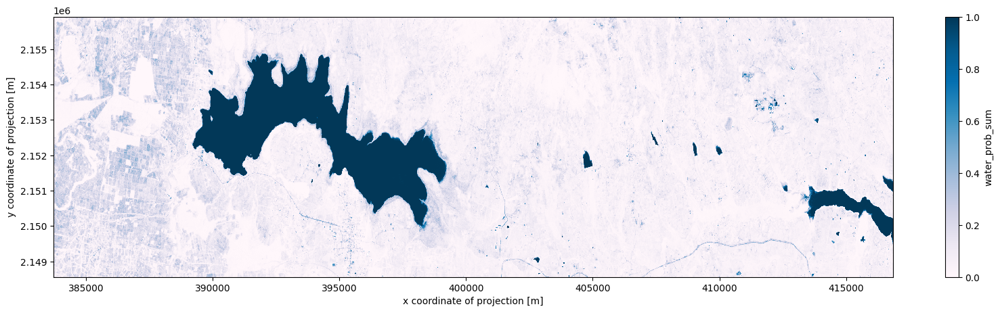

In [91]:

## create the masks so that the data is independent of each other.
s1_s2_mask = (s1_s2_water >= 0)
s2_mask = s2_median_water.mask(s1_s2_mask) >= 0
s1_mask = s1_median_water.mask(s1_s2_mask).mask(s2_mask) >= 0

# Masks need to be inverted
s1_s2_masked = s1_s2_water.mask(s1_s2_mask.apply(lambda x: x.eq(0)), replacement = 0)
s2_masked = s2_median_water.mask(s2_mask.apply(lambda x: x.eq(0)), replacement = 0)
s1_masked = s1_median_water.mask(s1_mask.apply(lambda x: x.eq(0)), replacement = 0)


merge_all = s1_s2_masked.merge_cubes(s2_masked, overlap_resolver='sum').merge_cubes(s1_masked, overlap_resolver='sum')
merge_all = merge_all.rename_labels("bands", ["water_prob_sum"])

# merge_save = merge_all.save_result(format='netCDF') #GTiff #netCDF
# my_job  = merge_save.send_job(title="merge_all")
# results = my_job.start_and_wait().get_results()
# results.download_files('merge_all')

ds_merge = xr.open_dataset("merge_all/openEO.nc").load()
ds_merge['water_prob_sum'].plot.imshow(x="x", robust=True, cmap = 'PuBu', vmin=0, vmax=1, figsize=(20, 5))

* B) Mask Urban Areas
Additionally, urban areas can cause confusion in both optical and SAR imagery, for example misclassification of roads, warehouses, and solar PV systems. These areas were removed using the ESA_WORLDCOVER_10M_2020_V1

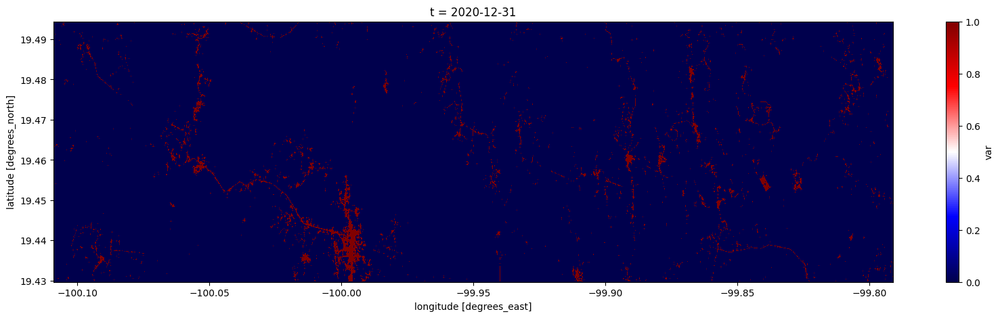

In [103]:
worldcover_cube = connection.load_collection("ESA_WORLDCOVER_10M_2020_V1", 
                                            temporal_extent = ['2020-12-30', '2021-01-01'], 
                                            spatial_extent = spatial_extent, 
                                            bands = ["MAP"])
                                         
builtup_mask = worldcover_cube.band("MAP") == 50

# builtup_mask_save = builtup_mask.save_result(format='netCDF') #GTiff #netCDF
# my_job  = builtup_mask_save.send_job(title="builtup_mask")
# results = my_job.start_and_wait().get_results()
# results.download_files('builtup_mask')

ds_builtup_mask = xr.open_dataset("builtup_mask/openEO.nc").load()
ds_builtup_mask['var'].plot(cmap = 'seismic',figsize=(20, 5))

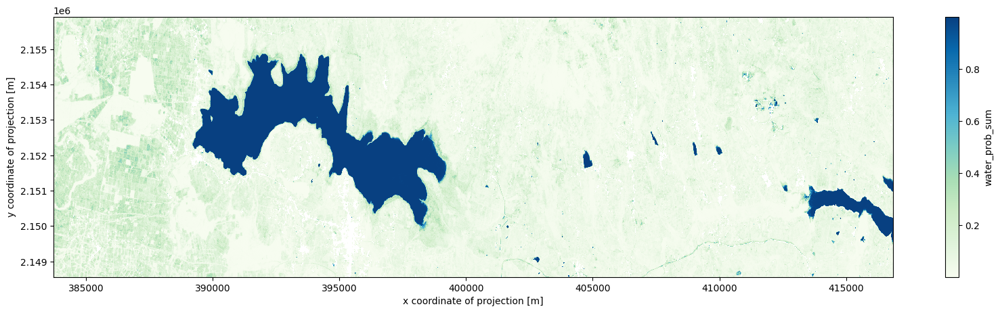

In [114]:
water_probability = merge_all.mask(builtup_mask.max_time().resample_cube_spatial(merge_all))

# water_probability_save = water_probability.save_result(format='netCDF') 
# my_job  = water_probability_save.send_job(title="water_probability")
# results = my_job.start_and_wait().get_results()
# results.download_files('water_probability')

ds_water_probability = xr.open_dataset("water_probability/openEO.nc").load()
ds_water_probability['water_prob_sum'].plot(cmap = 'GnBu', figsize=(20, 5))

* C) Applying the probability threshold to to convert it to a binary product.

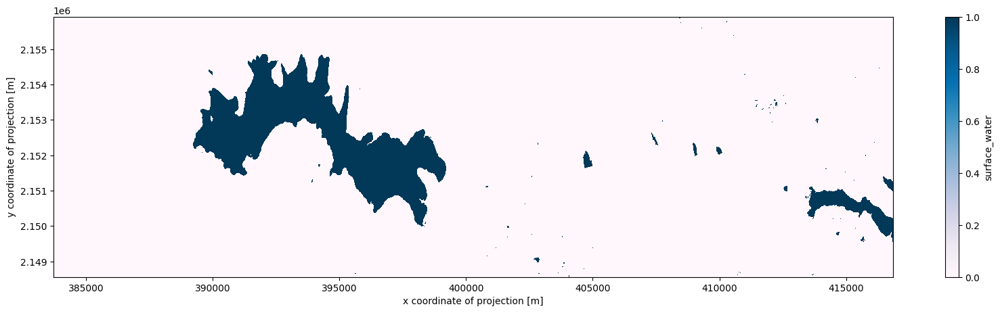

In [118]:

water_T75 = water_probability > 0.75
water_T75 = water_T75.rename_labels("bands", ["surface_water"])

# water_T75_save = water_T75.save_result(format='netCDF') #GTiff #netCDF
# my_job  = water_T75_save.send_job(title="water_T75")
# results = my_job.start_and_wait().get_results()
# results.download_files('water_T75')

ds_water_T75 = xr.open_dataset("water_T75/openEO.nc").load()
ds_water_T75['surface_water'].plot.imshow(x="x", robust=True, cmap ='PuBu' , vmin=0, vmax=1, figsize=(20, 5)); 
